In [1]:
%matplotlib inline

%load_ext autoreload
%autoreload 2
%reload_ext autoreload

import matplotlib.pyplot as plt

from skimage import morphology
import numpy as np
import cv2

from bing_maps import BingMaps

import utils

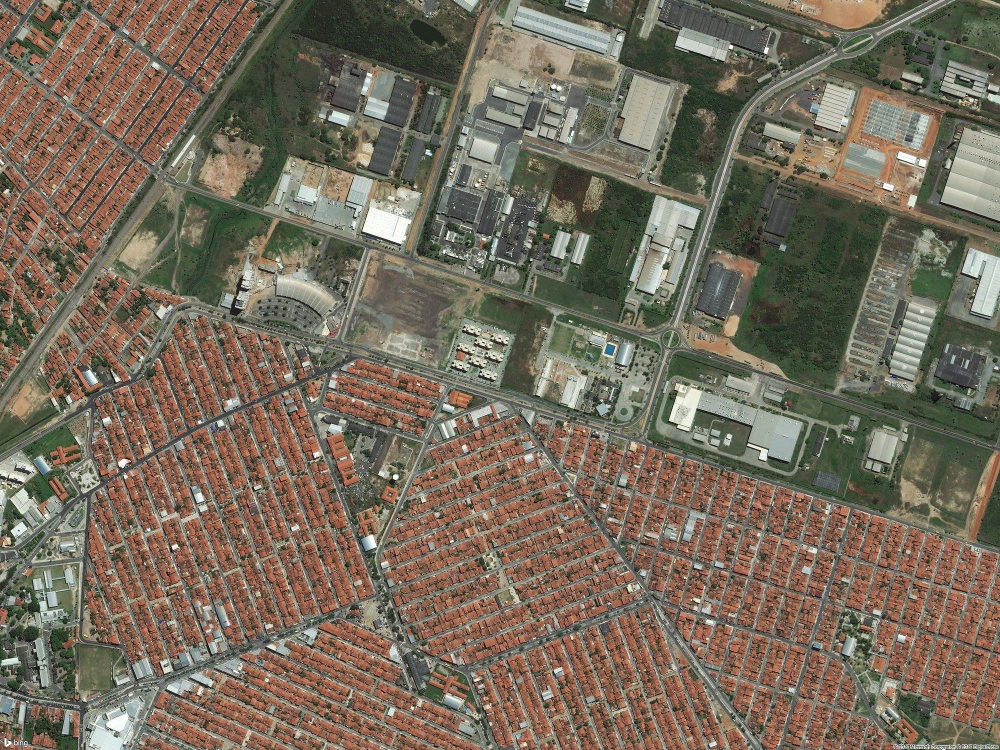

In [2]:
maps = BingMaps('AjhkGze8sCMwACt6rQMCS4ykL0gtBEyb6ku3Fqp78m9TsrrZ9qHHPAf_S8zjJFpR')

image = maps.image(-3.8722232, -38.6133724, 17, width=2000, height=1500)

image

## Casas e prédios

/home/paulo/anaconda3/lib/python3.5/site-packages/skimage/util/dtype.py:110: UserWarning: Possible precision loss when converting from float64 to uint8
  "%s to %s" % (dtypeobj_in, dtypeobj))


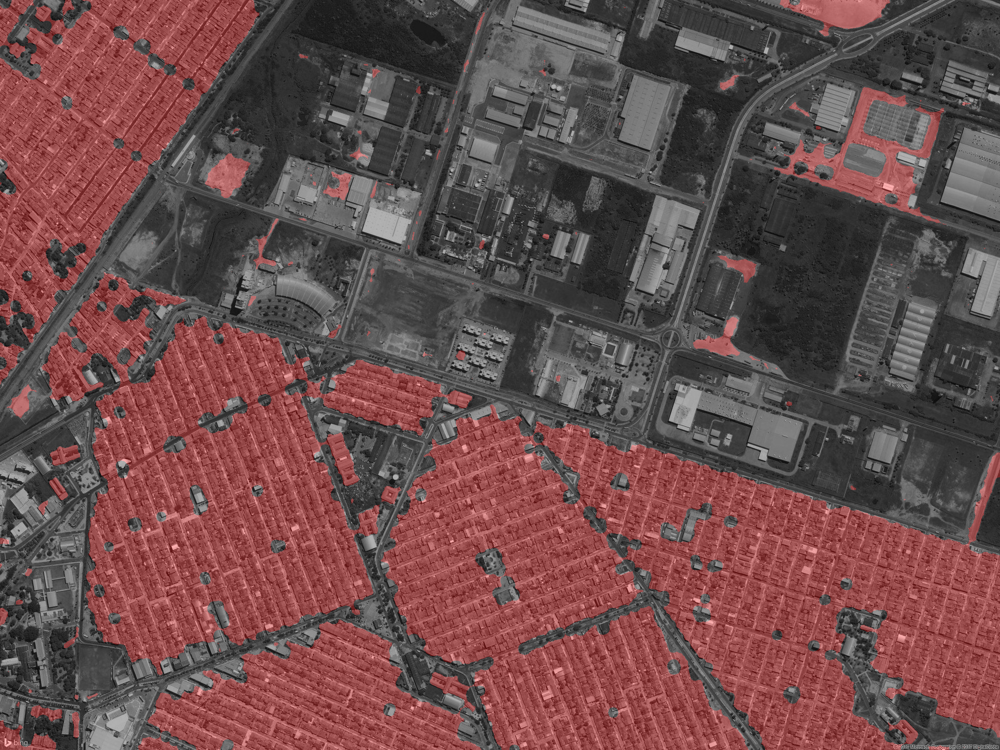

In [3]:
from areas_claras_detector import AreasClarasDetector
from areas_vermelhas_detector import AreasVermelhasDetector

from skimage.color import label2rgb


detector = AreasVermelhasDetector()

casas_mask = detector.processar_imagem_casa(image)
casas_mask_fechamento = morphology.closing(casas_mask, morphology.disk(10))

casas_marcadas = label2rgb(
    casas_mask_fechamento,
    image=np.asarray(image),
    bg_label=0
)

utils.skshow(casas_marcadas)

/home/paulo/anaconda3/lib/python3.5/site-packages/skimage/util/dtype.py:110: UserWarning: Possible precision loss when converting from float64 to uint8
  "%s to %s" % (dtypeobj_in, dtypeobj))


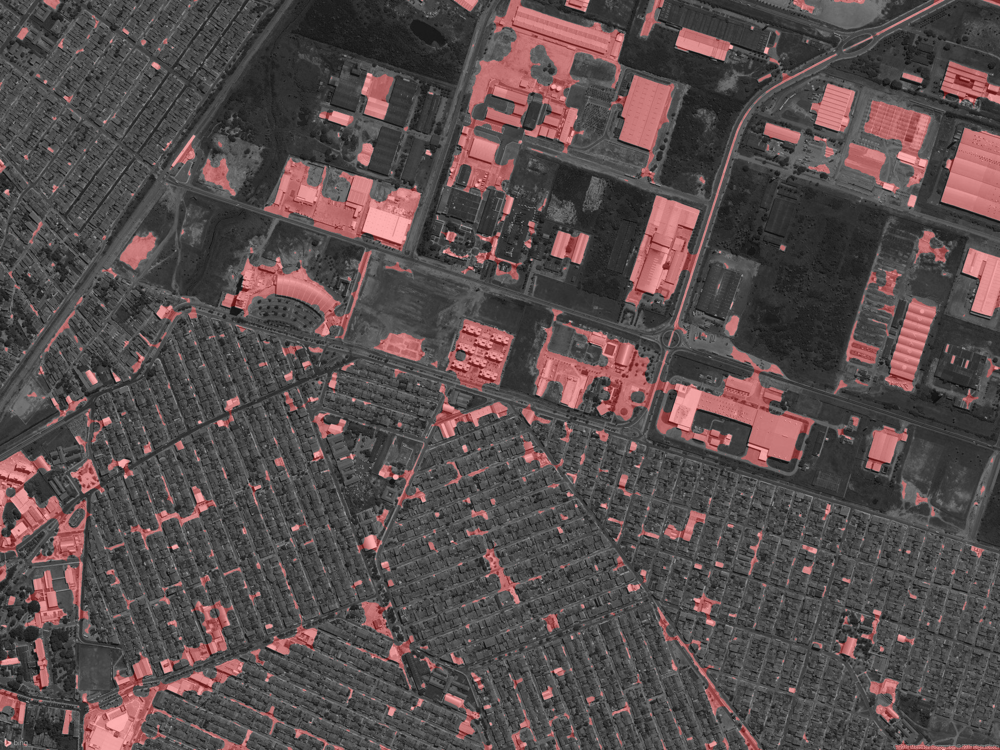

In [4]:
detector = AreasClarasDetector()
industrias_claras = detector.processar_imagem(np.asarray(image))

industrias_claras_fechamento = morphology.closing(industrias_claras, morphology.disk(10))

industrias_claras_marcadas = label2rgb(
    industrias_claras_fechamento,
    image=np.asarray(image),
    bg_label=0
)

utils.skshow(industrias_claras_marcadas)

/home/paulo/anaconda3/lib/python3.5/site-packages/skimage/util/dtype.py:110: UserWarning: Possible precision loss when converting from float64 to uint8
  "%s to %s" % (dtypeobj_in, dtypeobj))


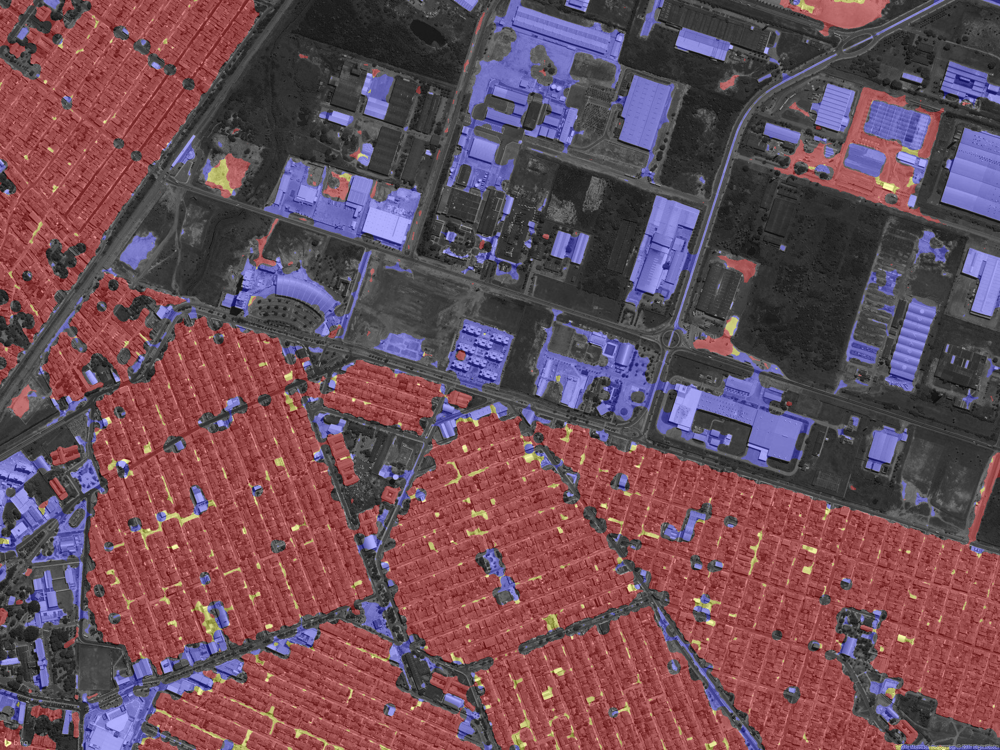

In [5]:
resultado = label2rgb(
    casas_mask_fechamento + industrias_claras_fechamento * 2,
    image=np.asarray(image),
    bg_label=0
)

utils.skshow(resultado)

## Ruas

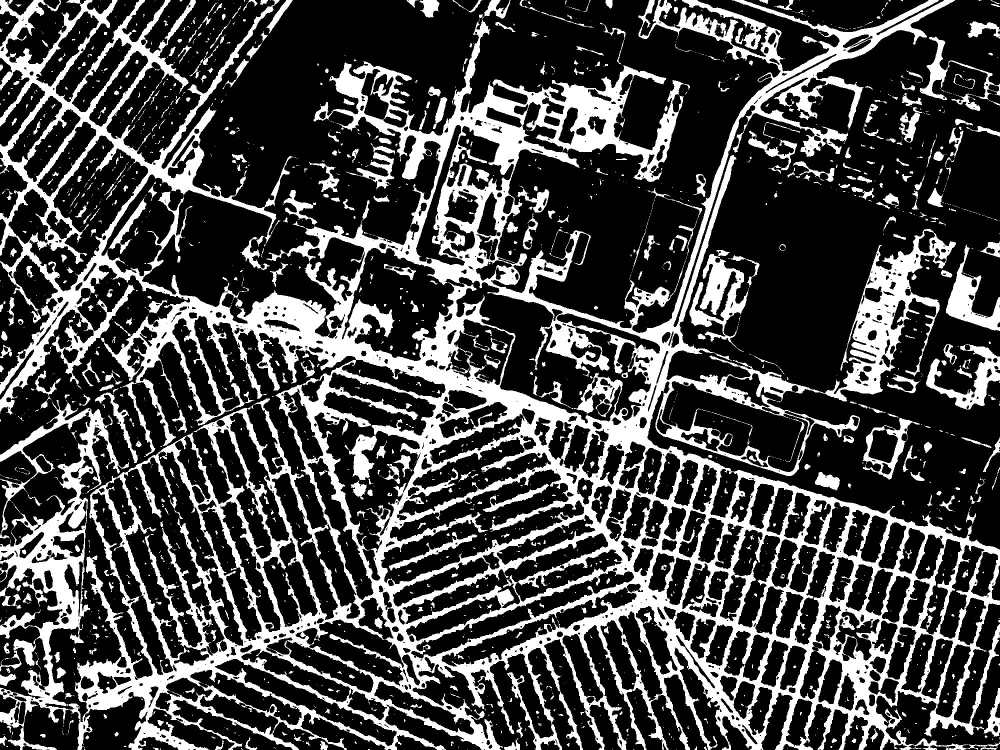

In [8]:
from ruas_detector import RuasDetector

ruas = RuasDetector().processar_imagem(image)

utils.skshow(ruas)

/home/paulo/anaconda3/lib/python3.5/site-packages/skimage/util/dtype.py:110: UserWarning: Possible precision loss when converting from float64 to uint8
  "%s to %s" % (dtypeobj_in, dtypeobj))


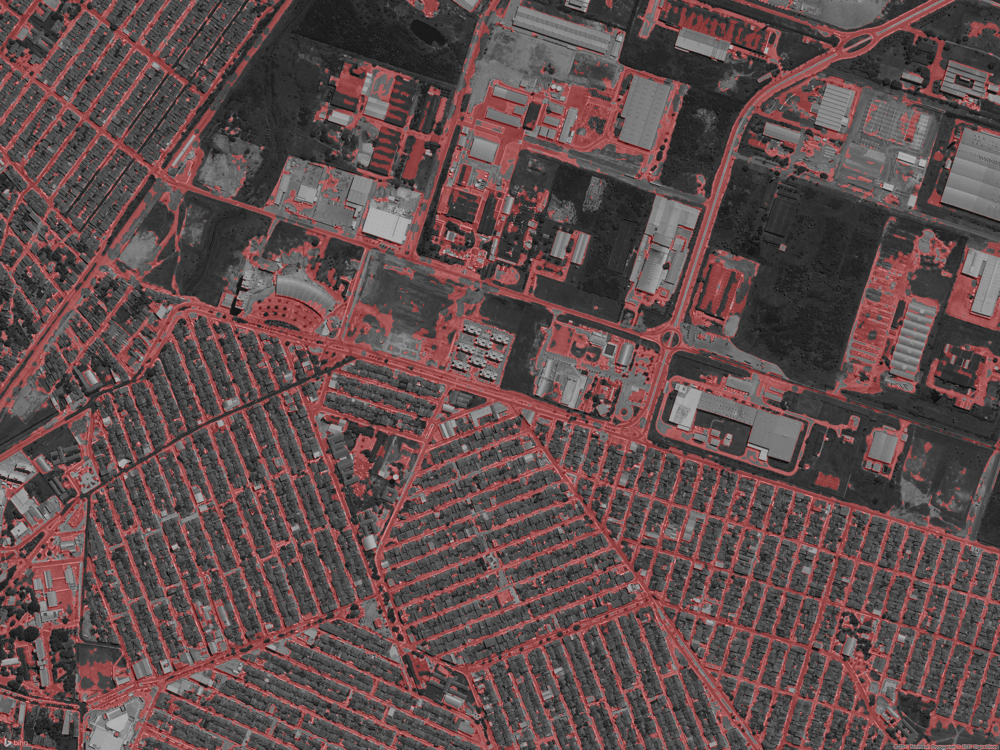

In [9]:
resultado = label2rgb(
    ruas,
    image=np.asarray(image),
    bg_label=0
)

utils.skshow(resultado)

## Resultado final

/home/paulo/anaconda3/lib/python3.5/site-packages/skimage/util/dtype.py:110: UserWarning: Possible precision loss when converting from float64 to uint8
  "%s to %s" % (dtypeobj_in, dtypeobj))


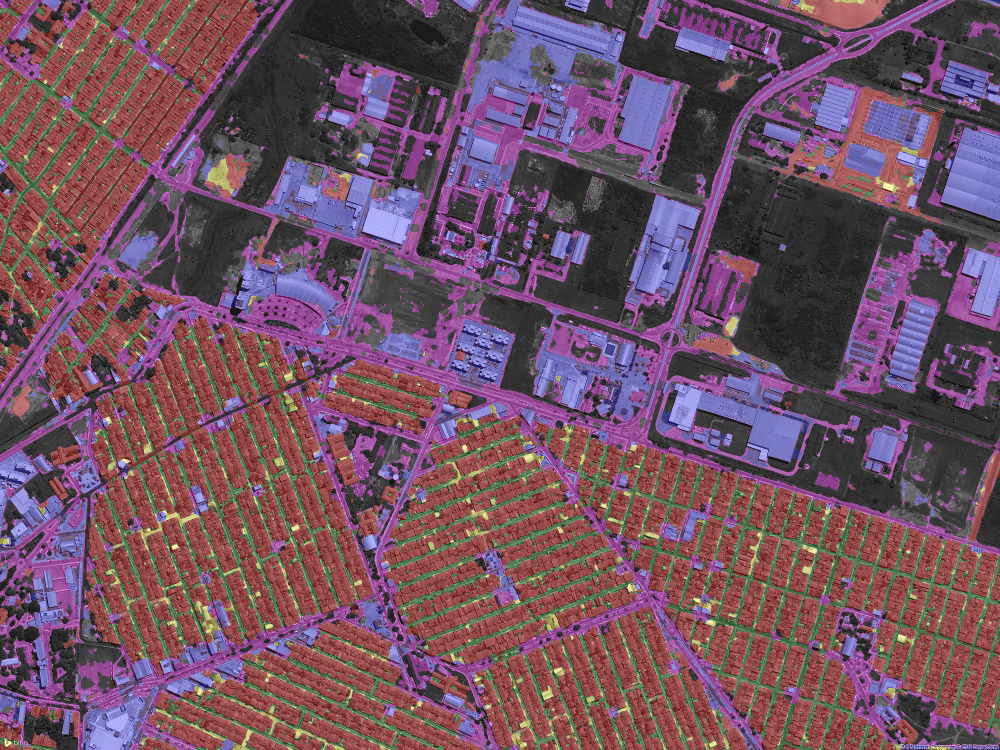

In [7]:
resultado = label2rgb(
    casas_mask_fechamento 
  + industrias_claras_fechamento * 2
  + ruas * 4,
    image=np.asarray(image),
    bg_label=0,
    #colors=[(1,0,0), (0,1,0), (0,0,1), (0,1,1), (1,0,1)]
)

utils.skshow(resultado)